In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
!nvidia-smi

Mon Apr  8 20:55:32 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   33C    P8               9W /  70W |      0MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [1]:
!pip install ikomia

In [2]:
import requests
import zipfile
import os

In [3]:
dataset_dir = '/content/drive/MyDrive/amt3/bbproject/dataset'
weights_dir = '/content/drive/MyDrive/amt3/bbproject/weights'
classes_yaml_dir = '/content/drive/MyDrive/amt3/bbproject'
output_video_path = '/content/drive/MyDrive/amt3/bbproject/output_video.mp4'


In [4]:
os.makedirs(dataset_dir, exist_ok=True)
os.makedirs(weights_dir, exist_ok=True)

#Loading the custome dataset from Roboflow


In [7]:
# Commented as the dataset is already downloaded in the drive


# # Download the dataset
# url = "https://universe.roboflow.com/ds/OG5R1BjHfr?key=U5vq9IGzOH"
# response = requests.get(url, stream=True)
# dataset_zip_path = os.path.join(dataset_dir, "roboflow.zip")
# with open(dataset_zip_path, "wb") as file:
#     for chunk in response.iter_content(chunk_size=8192):
#         file.write(chunk)

# # Unzip the dataset
# with zipfile.ZipFile(dataset_zip_path, 'r') as zip_ref:
#     zip_ref.extractall(dataset_dir)

# # Remove the zip file
# # os.remove(dataset_zip_path)


In [5]:
ls /content/drive/MyDrive/amt3/bbproject/dataset/

README.dataset.txt  README.roboflow.txt  roboflow.zip  test/  train/  valid/


# Assigning Folder Paths


In [6]:
import os

# Set your Google Drive project folder path
project_folder = '/content/drive/MyDrive/amt3/bbproject'
print("Project Folder:", project_folder)

# Assuming that the dataset has been placed in a subfolder named 'dataset'
dataset_folder = os.path.join(project_folder, 'dataset')
print("Dataset Folder:", dataset_folder)

train_dataset_folder = os.path.join(dataset_folder, 'train')
print("Train Dataset Folder:", train_dataset_folder)

# Output folder for training results (model weights, etc.)
output_folder = os.path.join(project_folder, 'training_output')
print("Training Output Folder:", output_folder)

val_dataset_folder =  os.path.join(dataset_folder, 'val')
print("Val Dataset Folder:", val_dataset_folder)


# Make sure the output directory exists
# os.makedirs(output_folder, exist_ok=True)


Project Folder: /content/drive/MyDrive/amt3/bbproject
Dataset Folder: /content/drive/MyDrive/amt3/bbproject/dataset
Train Dataset Folder: /content/drive/MyDrive/amt3/bbproject/dataset/train
Training Output Folder: /content/drive/MyDrive/amt3/bbproject/training_output
Val Dataset Folder: /content/drive/MyDrive/amt3/bbproject/dataset/val


## Initializing Ikomia for model workflow

In [ ]:
from ikomia.dataprocess.workflow import Workflow

# Initialize the Workflow
wf = Workflow()

## Data Pre-Processing - Coverting the datset from coco to IKOMIA Format

In [ ]:

# Convert the COCO format to IKOMIA format
dataset = wf.add_task(name="dataset_coco")
dataset.set_parameters({
    "json_file": os.path.join(train_dataset_folder, "_annotations.coco.json"),
    "image_folder": train_dataset_folder,
    "task": "detection",
    "output_folder": dataset_folder  # Adjusted to the dataset folder in Google Drive
})


## Train YOLOv9 model with the dataset


In [ ]:
# Train YOLOv9 model
train = wf.add_task(name="train_yolo_v9", auto_connect=True)
train.set_parameters({
    "model_name": "yolov9-c",
    "epochs": "50",
    "batch_size": "8",
    "train_imgsz": "640",
    "test_imgsz": "640",
    "dataset_split_ratio": "0.8",
    "output_folder": output_folder
})

## Execute the workflow

In [ ]:
wf.run()



## Training Overview

- **Performance Improvement**: Significant enhancements in precision, recall, and mAP scores over 50 epochs.
- **Loss Reduction**: Decreased losses in box, class, and dfl predictions indicate growing model accuracy.
- **Learning Rate Management**: Progressive reduction in learning rates enabled fine-tuning of model performance.

## Key Insights

- **Peak Performance**: Highest precision and mAP values towards the end signal substantial predictive improvement.
- **Validation vs. Training Loss**: Lower validation losses may suggest overfitting or non-representative validation data.


## Code to generate plots with the results

In [20]:
%matplotlib inline

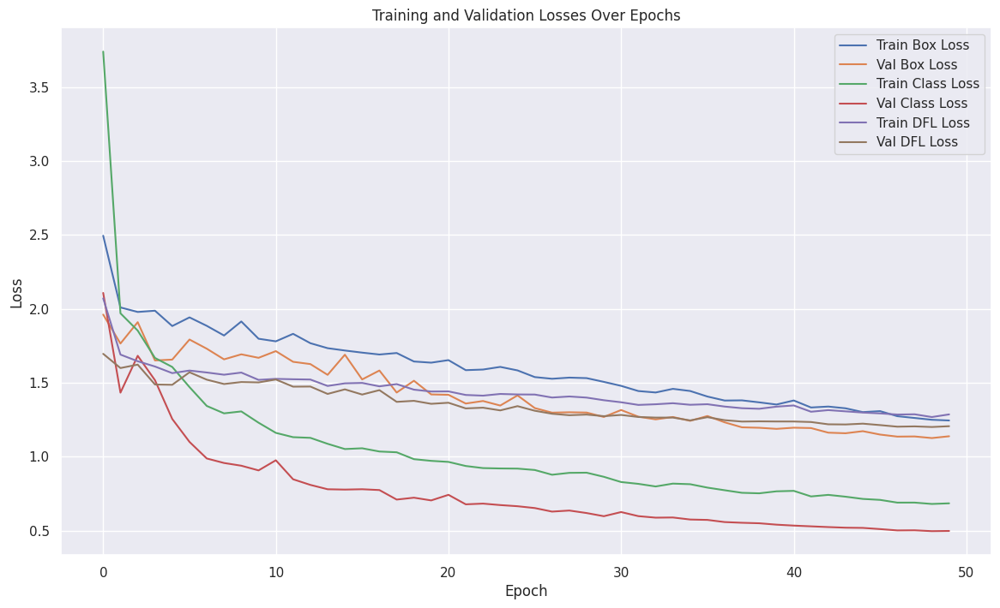

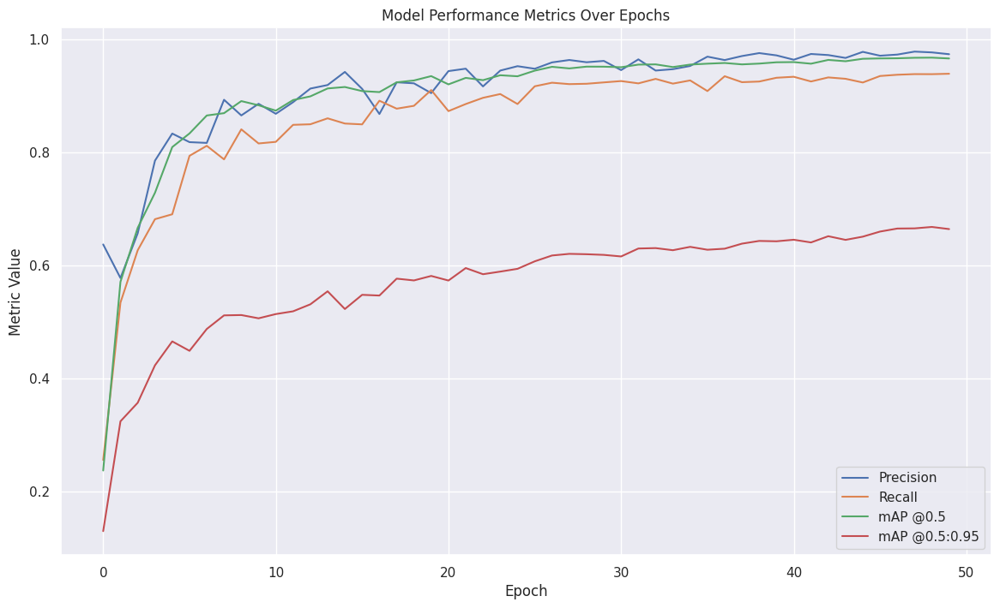

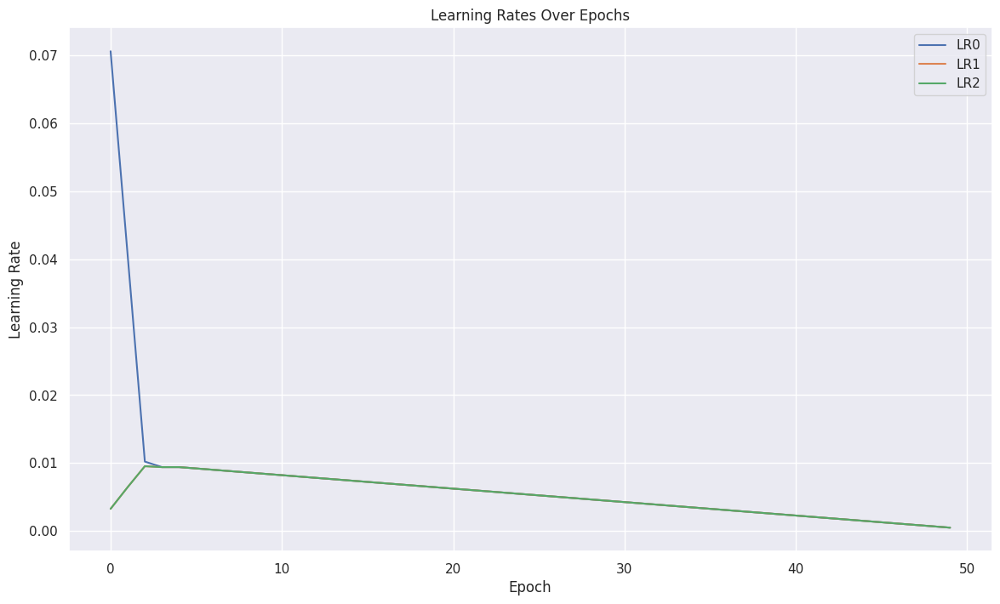

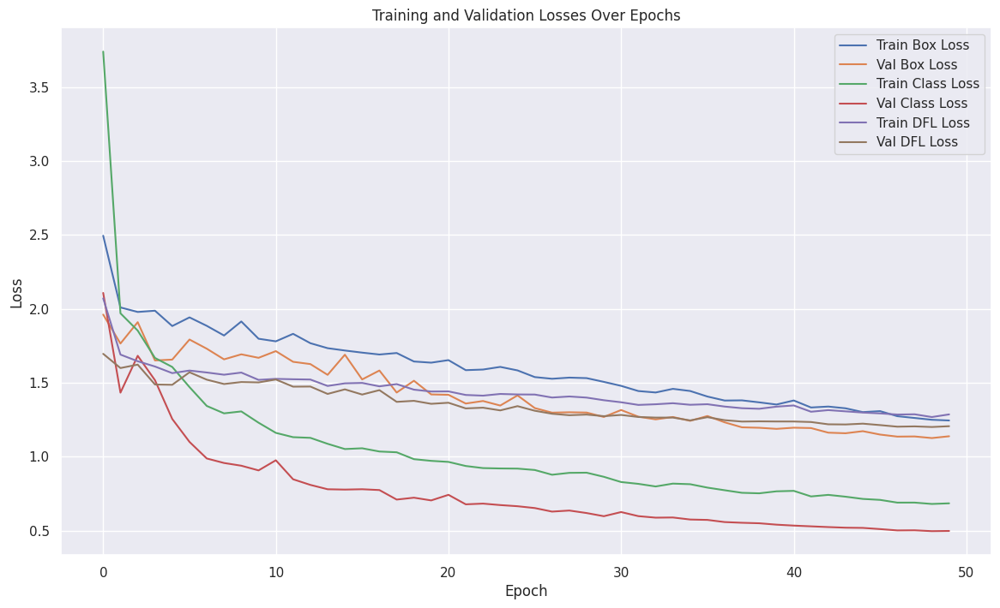

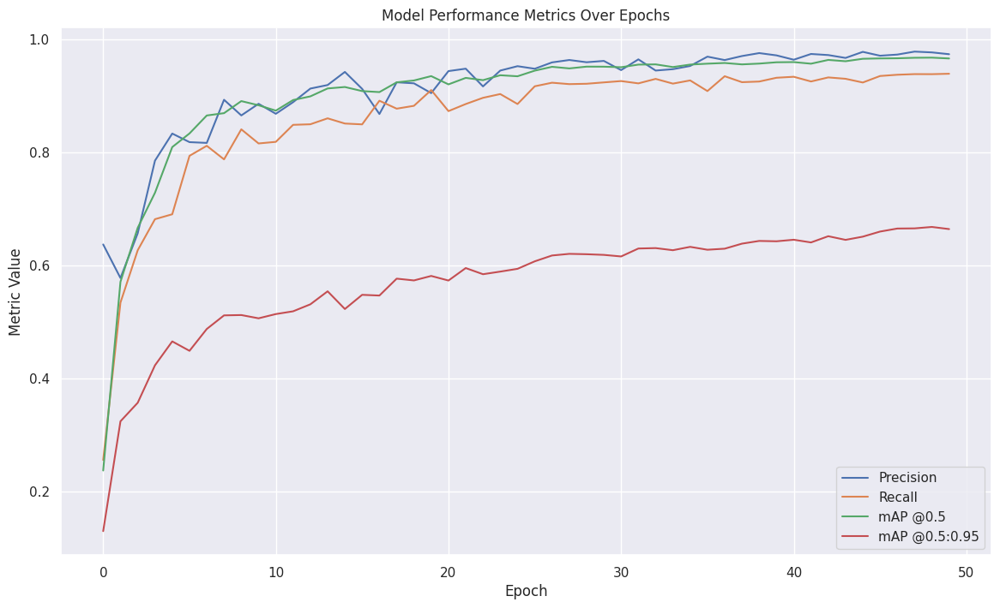

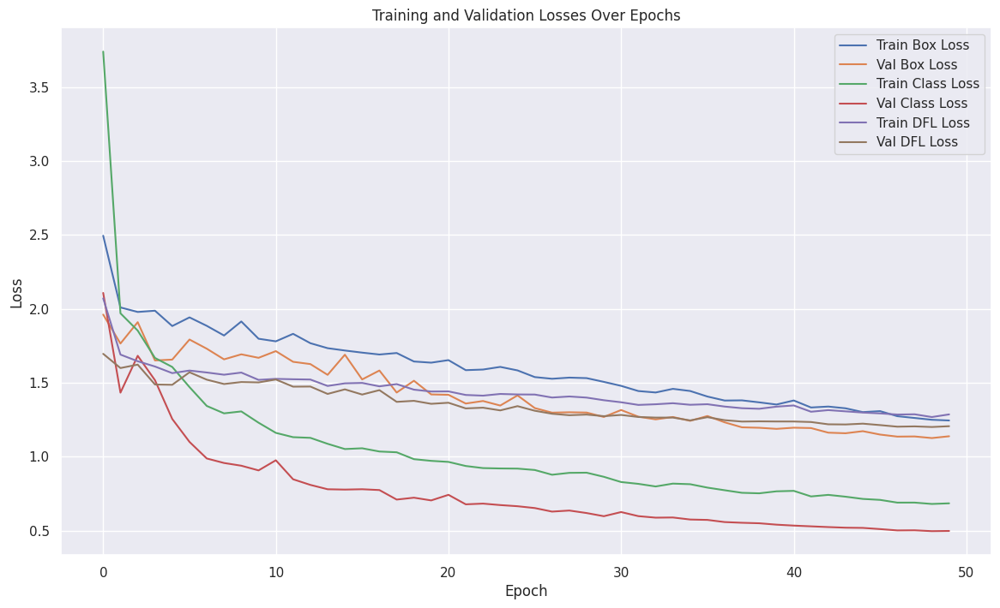

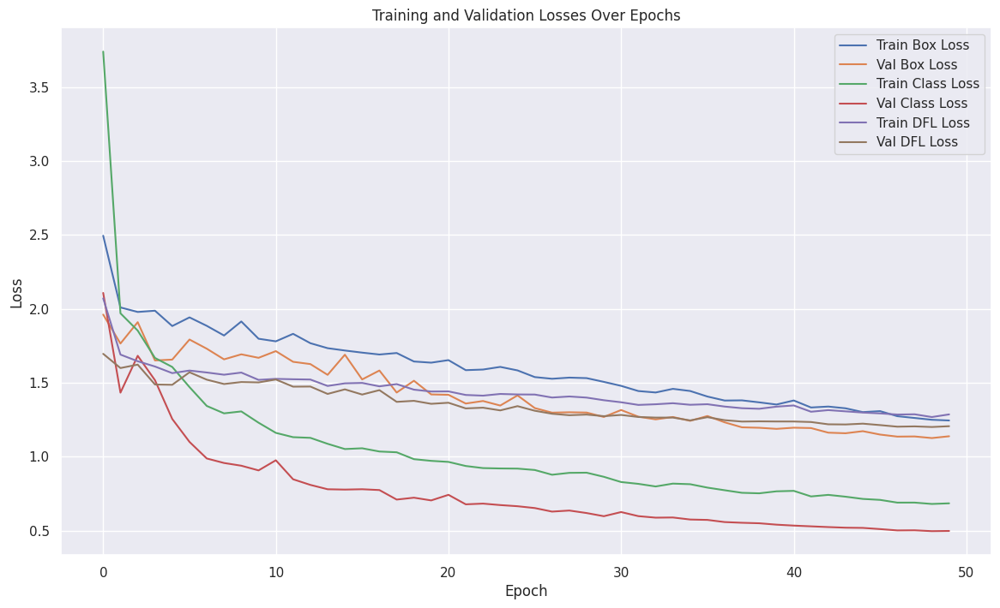

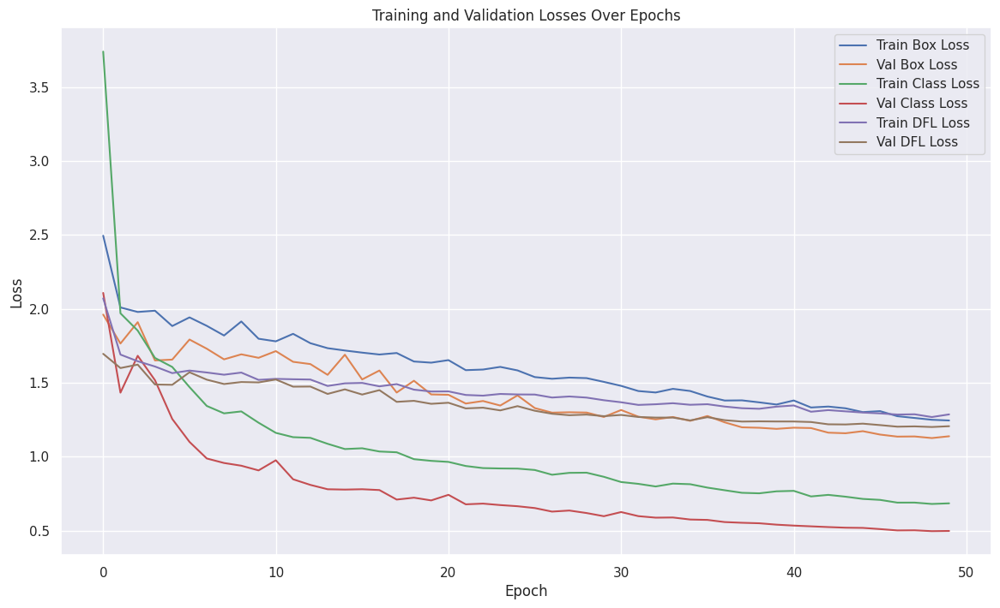

In [21]:
import pandas as pd
import matplotlib.pyplot as plt

# Load data from CSV file
data_path = '/content/drive/MyDrive/amt3/bbproject/training_output/08-04-2024T09h08m57s/results.csv'
df = pd.read_csv(data_path)

# Strip whitespace from column names
df.columns = df.columns.str.strip()

# Plot training and validation losses
plt.figure(figsize=(14, 8))
plt.plot(df['epoch'], df['train/box_loss'], label='Train Box Loss')
plt.plot(df['epoch'], df['val/box_loss'], label='Val Box Loss')
plt.plot(df['epoch'], df['train/cls_loss'], label='Train Class Loss')
plt.plot(df['epoch'], df['val/cls_loss'], label='Val Class Loss')
plt.plot(df['epoch'], df['train/dfl_loss'], label='Train DFL Loss')
plt.plot(df['epoch'], df['val/dfl_loss'], label='Val DFL Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training and Validation Losses Over Epochs')
plt.legend()
plt.show()

### Training Losses:

* Box Loss: The training box loss begins at a high value but shows a rapid decline within the initial epochs, suggesting a swift improvement in the model's capability to predict the correct bounding boxes around the objects of interest.
* Classification Loss: The training classification loss follows a similar trend, with a steep decrease initially, which then plateaus, indicating that the model is becoming better at correctly identifying the classes of the objects within the bounding boxes.
* DFL Loss: The direction-focused loss on the training set, although starting lower than the other two losses, decreases steadily, pointing towards an enhancement in the model’s accuracy in predicting object orientations or other direction-focused tasks.

### Validation Losses:

* Box Loss: The validation box loss exhibits a descent analogous to the training box loss, albeit with less volatility, which implies that the model’s generalization to unseen data is improving in terms of locating objects.
* Classification Loss: The validation classification loss decreases more gradually compared to the training loss, suggesting a consistent improvement in the model's generalization power for object classification.
* DFL Loss: The validation DFL loss shows an initial drop and then levels out, maintaining a close correspondence with the training DFL loss. This near-parallel trajectory with the training loss is indicative of good generalization for the direction-focused tasks.

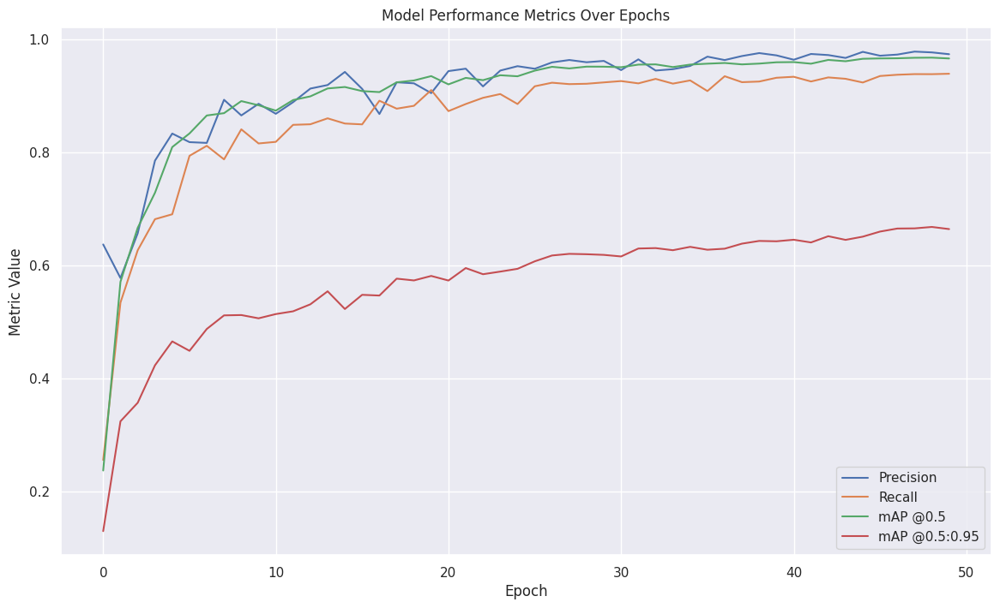

In [22]:

# Plot metrics (precision, recall, mAP)
plt.figure(figsize=(14, 8))
plt.plot(df['epoch'], df['metrics/precision'], label='Precision')
plt.plot(df['epoch'], df['metrics/recall'], label='Recall')
plt.plot(df['epoch'], df['metrics/mAP_0.5'], label='mAP @0.5')
plt.plot(df['epoch'], df['metrics/mAP_0.5:0.95'], label='mAP @0.5:0.95')
plt.xlabel('Epoch')
plt.ylabel('Metric Value')
plt.title('Model Performance Metrics Over Epochs')
plt.legend()
plt.show()




### Model Performance Metrics Over Epochs

The graph illustrates the evolution of key performance metrics throughout the training process, spanning over 50 epochs. These metrics include precision, recall, mean Average Precision (mAP) at an Intersection over Union (IoU) threshold of 0.5, and mAP calculated over a range of IoU thresholds from 0.5 to 0.95.

#### Precision (Blue Line)

Precision quantifies the proportion of positive identifications that were actually correct. The graph shows that precision quickly increases during the early training phases, indicating an initial rapid learning phase. It then stabilizes, suggesting that the model consistently makes accurate predictions as training progresses.

#### Recall (Green Line)

Recall measures the fraction of actual positives that were identified correctly. Similar to precision, recall improves significantly in the initial epochs before reaching a plateau. This behavior demonstrates the model's ability to detect the majority of relevant instances in the dataset.

#### mAP @0.5 (Orange Line)

The mAP at an IoU threshold of 0.5 evaluates both precision and recall at this specific threshold level. This metric experiences a steep rise early in the training and levels off thereafter, which is indicative of a model that quickly becomes proficient in predicting object locations with a reasonable overlap criterion.

#### mAP @0.5:0.95 (Red Line)

This metric computes the mAP across a range of IoU thresholds, providing a more nuanced understanding of model performance. It's generally regarded as a more comprehensive and challenging performance metric. In the graph, this metric mirrors the initial improvement seen in other metrics but plateaus at a lower level, reflecting the increased difficulty of maintaining high precision across various levels of strictness in object localization.


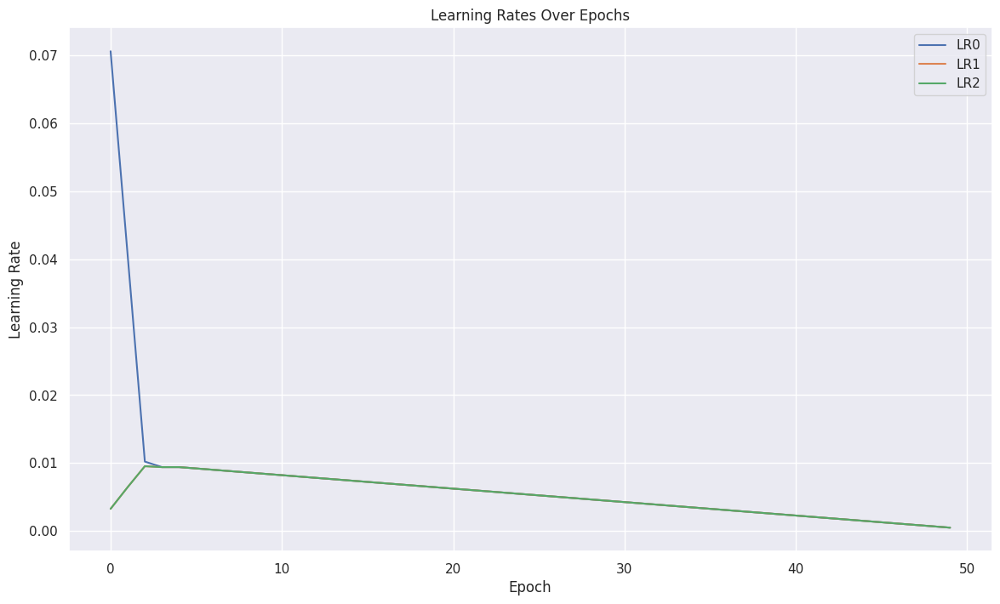

In [23]:
# Plot learning rates
plt.figure(figsize=(14, 8))
plt.plot(df['epoch'], df['x/lr0'], label='LR0')
plt.plot(df['epoch'], df['x/lr1'], label='LR1')
plt.plot(df['epoch'], df['x/lr2'], label='LR2')
plt.xlabel('Epoch')
plt.ylabel('Learning Rate')
plt.title('Learning Rates Over Epochs')
plt.legend()
plt.show()

### Learning Rates Over Epochs

The provided graph illustrates the change in learning rates (LR0, LR1, and LR2) over a span of approximately 50 epochs during the training of a machine learning model.

#### LR0 (Blue Line)

- The initial learning rate, LR0, is observed to start at a high magnitude, indicating an aggressive approach to weight updates at the beginning of training.
- A precipitous drop is seen in the initial epochs, which may suggest an adaptive learning rate schedule that reduces the rate to refine the model's weight adjustments as it starts to converge.

#### LR1 (Orange Line)

- LR1 begins at a lower value compared to LR0, but it exhibits a minor increase before settling quickly to a stable level.
- This behavior might correspond to an optimization algorithm that adjusts the learning rate in reaction to the model's performance metrics, allowing for a temporary increase if deemed beneficial.

#### LR2 (Green Line)

- This learning rate remains consistent throughout the training process, implying a fixed learning rate strategy.
- The uniformity of LR2 could indicate its application to certain layers or parameters within the model that do not necessitate dynamic learning rate adjustments, possibly due to architectural decisions like freezing certain layers during training.

The graph reflects a strategic approach to learning rate adjustments, where larger steps are taken initially to move closer to optimal weights, followed by smaller steps to fine-tune the model's performance. Such a strategy helps balance the speed of convergence with the accuracy of the model's final parameters.



Training Overview
Performance Improvement: Significant enhancements in precision, recall, and mAP scores over 50 epochs.
Loss Reduction: Decreased losses in box, class, and dfl predictions indicate growing model accuracy.
Learning Rate Management: Progressive reduction in learning rates enabled fine-tuning of model performance.
Key Insights
Peak Performance: Highest precision and mAP values towards the end signal substantial predictive improvement.
Validation vs. Training Loss: Lower validation losses may suggest overfitting or non-representative validation data.

#Results

In [26]:
TIMESTAMP = "08-04-2024T09h08m57s"
# TIMESTAMP = "08-04-2024T18h44m03s"

In [28]:
from ikomia.dataprocess.workflow import Workflow
wf = Workflow()

# Add YOLOv9 to your workflow
yolov9 = wf.add_task(name="infer_yolo_v9", auto_connect=True)
path = '/drive/MyDrive/amt3/bbproject/training_output/'
yolov9.set_parameters({
    "model_weight_file": os.getcwd()+ f'/{path}/{TIMESTAMP}/weights/best.pt',
    "class_file": os.getcwd()+ f'/{TIMESTAMP}/classes.yaml',
    "conf_thres": "0.2",
    "iou_thres":"0.25",
    "input_size":"640"
})

A_Jrl2uawkkDi_Kf.jpg: 100%|██████████| 197k/197k [00:00<00:00, 6.60MiB/s]


Will run on cuda


Fusing layers... 
yolov9-c summary: 724 layers, 50979420 parameters, 0 gradients, 237.8 GFLOPs


Workflow Untitled run successfully in 8303.018186 ms.


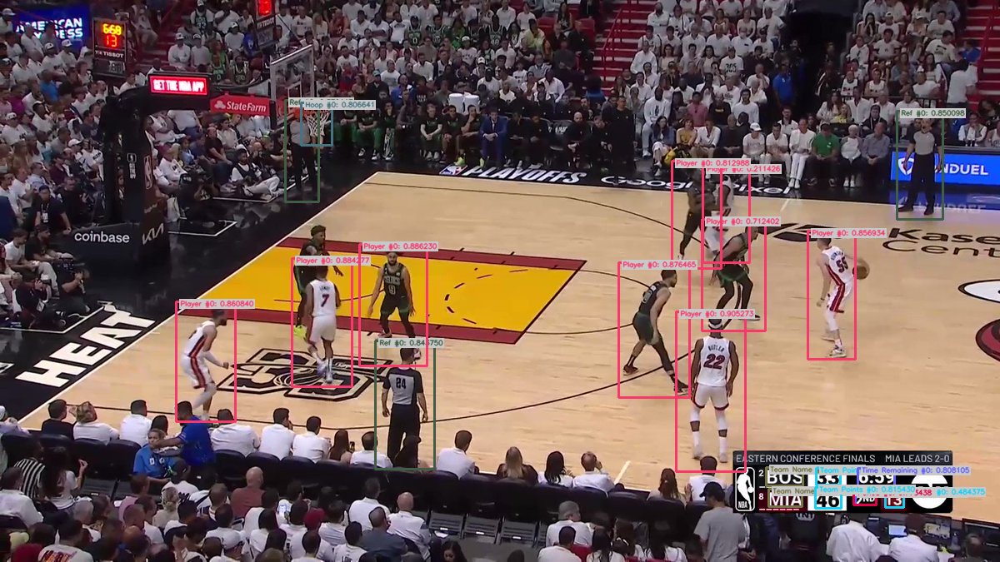

In [29]:
from ikomia.utils.displayIO import display
from PIL import ImageShow
ImageShow.register(ImageShow.IPythonViewer(), 0)

# Apply YOLOv9 object detection on your image
wf.run_on(url="https://pbs.twimg.com/ext_tw_video_thumb/1660454979298115585/pu/img/A_Jrl2uawkkDi_Kf.jpg")

# Get YOLOv9 image result
img_bbox = yolov9.get_image_with_graphics()

# Display in Colab
display(img_bbox)

* Processed a video file frame by frame.
* Applied YOLOv9 object detection on each frame.
* Overlayed detection results on the original frames.
* Saved processed frames to an output video file.
* Displays processed frames in the notebook.

Will run on cuda


Fusing layers... 
yolov9-c summary: 724 layers, 50979420 parameters, 0 gradients, 237.8 GFLOPs


Workflow Untitled run successfully in 8650.517527 ms.


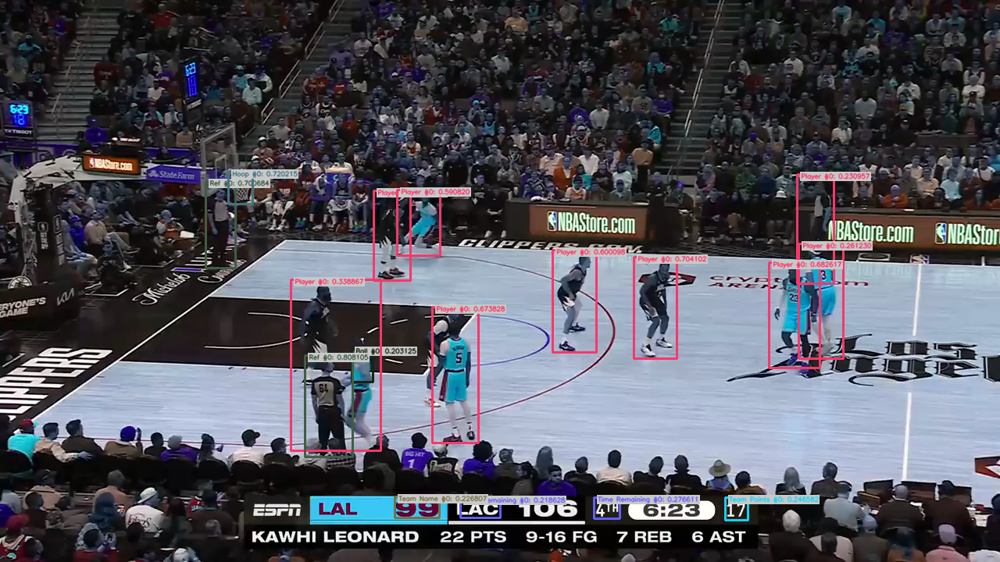

Will run on cuda


Fusing layers... 
yolov9-c summary: 724 layers, 50979420 parameters, 0 gradients, 237.8 GFLOPs


Workflow Untitled run successfully in 1217.087631 ms.


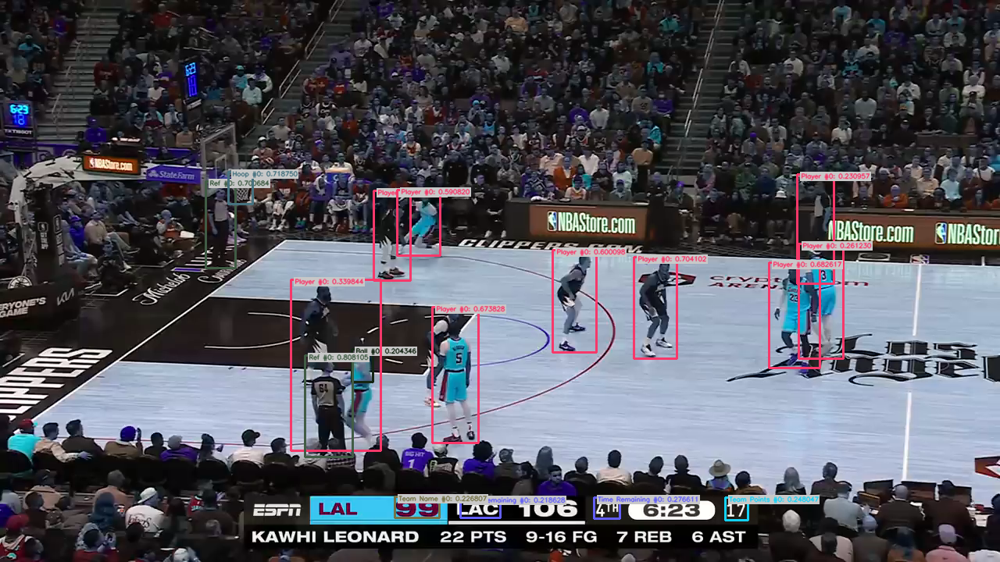

Will run on cuda


Fusing layers... 
yolov9-c summary: 724 layers, 50979420 parameters, 0 gradients, 237.8 GFLOPs


Workflow Untitled run successfully in 1257.816084 ms.


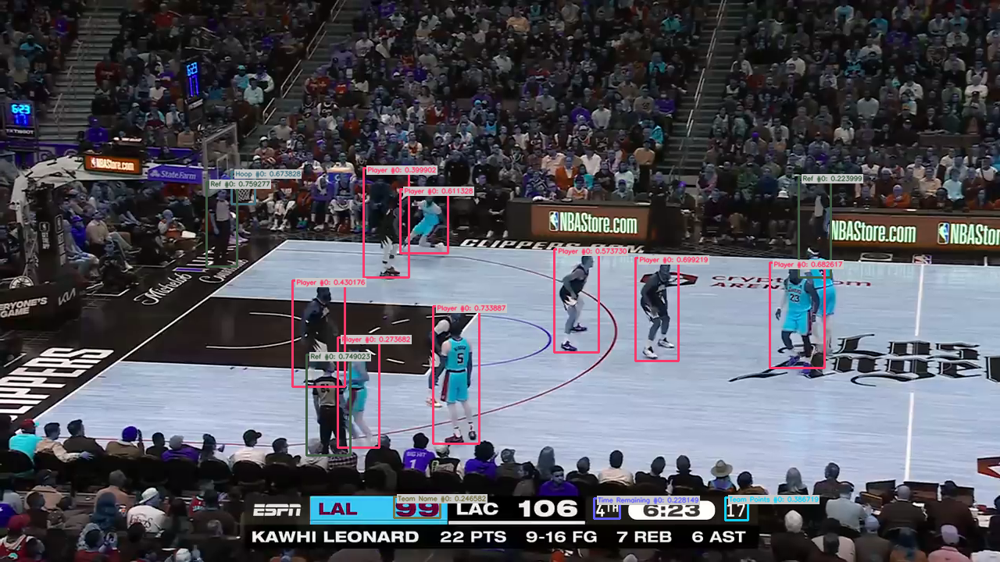

Will run on cuda


Fusing layers... 
yolov9-c summary: 724 layers, 50979420 parameters, 0 gradients, 237.8 GFLOPs


Workflow Untitled run successfully in 1591.63279 ms.


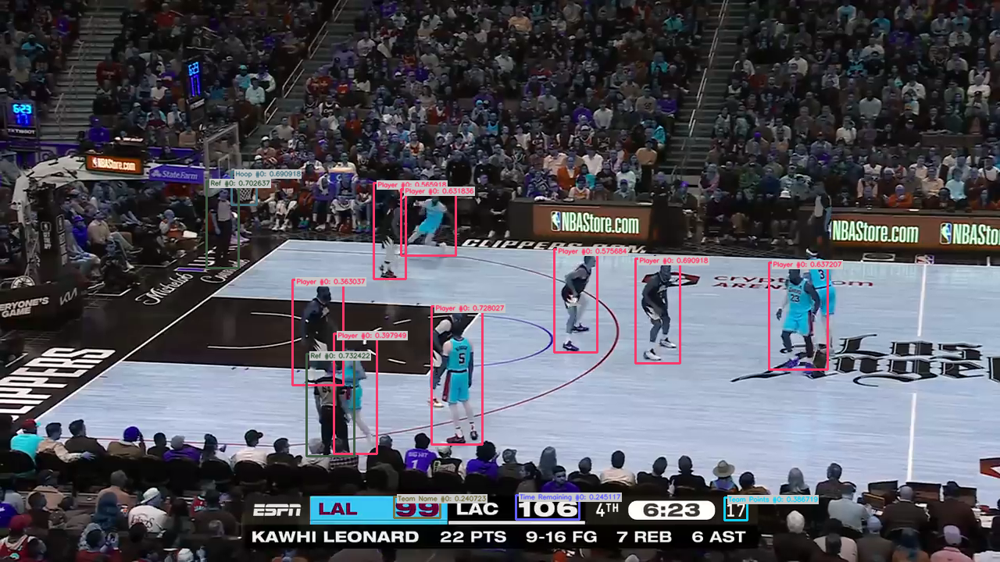

Will run on cuda


Fusing layers... 
yolov9-c summary: 724 layers, 50979420 parameters, 0 gradients, 237.8 GFLOPs


Workflow Untitled run successfully in 1199.912988 ms.


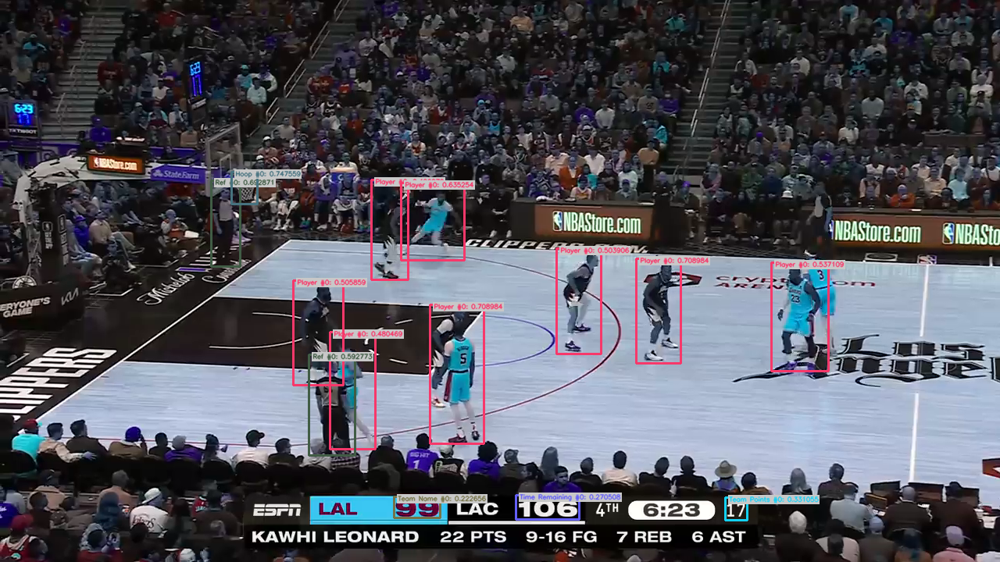

Will run on cuda


Fusing layers... 
yolov9-c summary: 724 layers, 50979420 parameters, 0 gradients, 237.8 GFLOPs


Workflow Untitled run successfully in 1199.172283 ms.


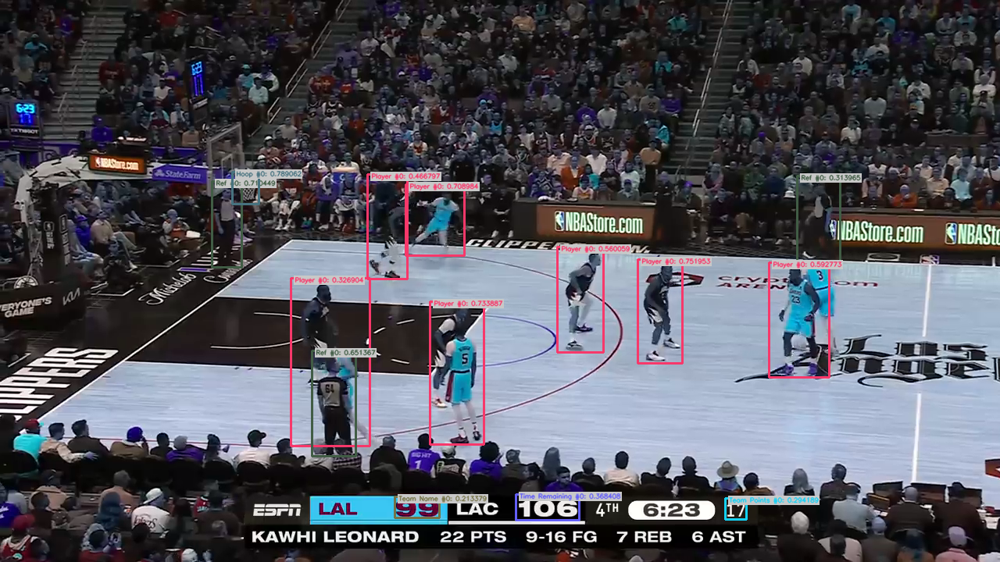

Will run on cuda


Fusing layers... 
yolov9-c summary: 724 layers, 50979420 parameters, 0 gradients, 237.8 GFLOPs


Workflow Untitled run successfully in 1183.576373 ms.


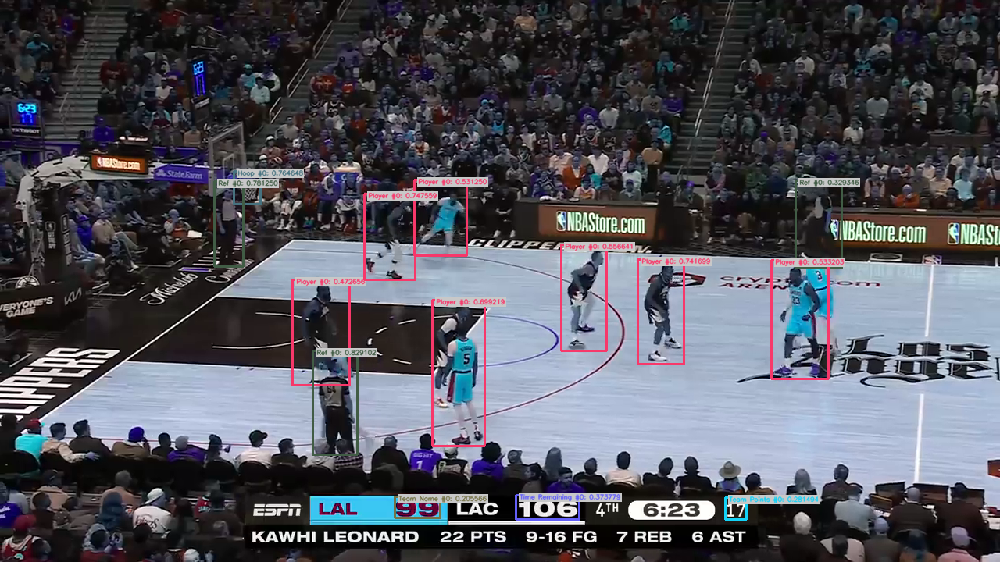

Will run on cuda


Fusing layers... 
yolov9-c summary: 724 layers, 50979420 parameters, 0 gradients, 237.8 GFLOPs


Workflow Untitled run successfully in 1534.754745 ms.


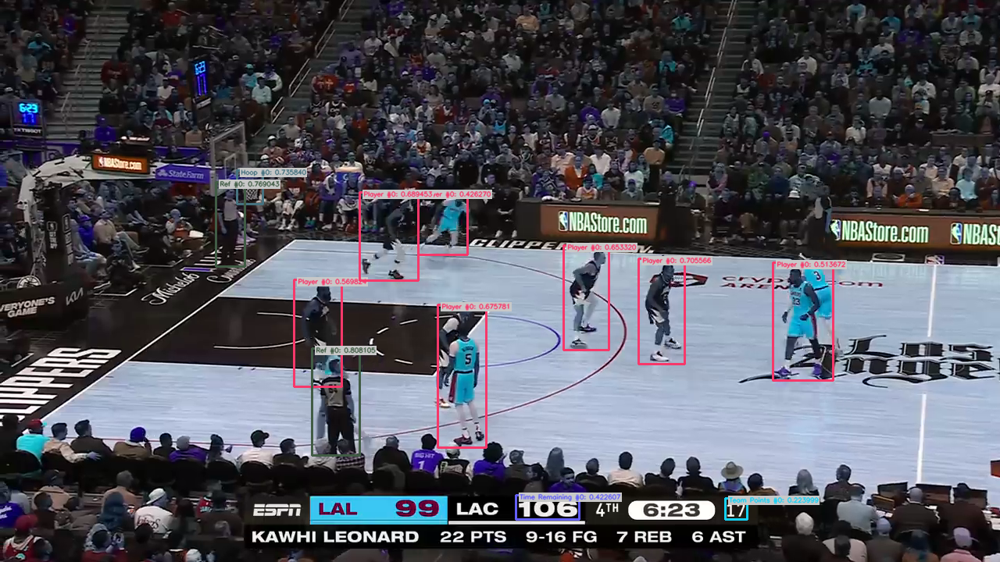

Will run on cuda


Fusing layers... 
yolov9-c summary: 724 layers, 50979420 parameters, 0 gradients, 237.8 GFLOPs


Workflow Untitled run successfully in 1266.725349 ms.


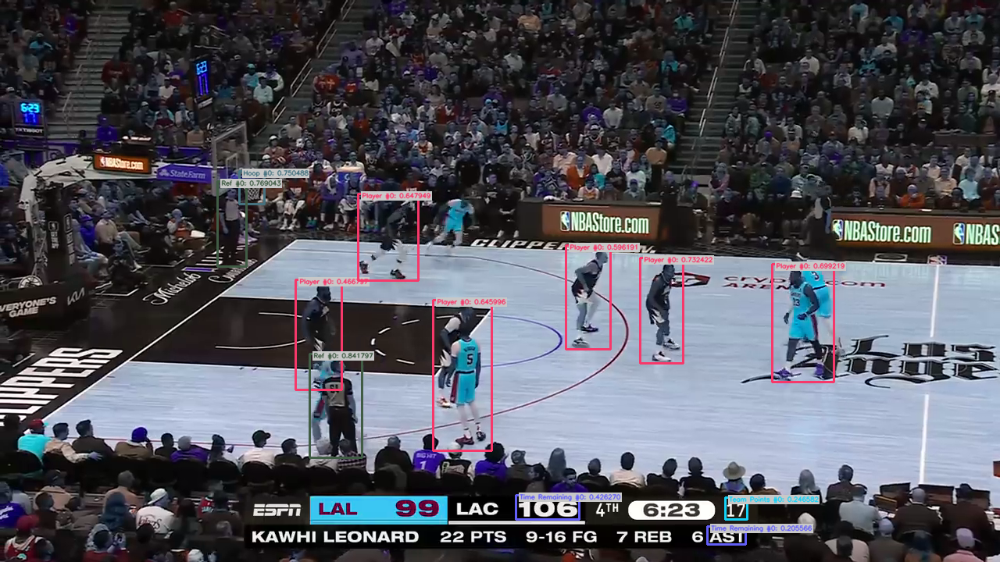

Will run on cuda


Fusing layers... 
yolov9-c summary: 724 layers, 50979420 parameters, 0 gradients, 237.8 GFLOPs


Workflow Untitled run successfully in 1223.05435 ms.


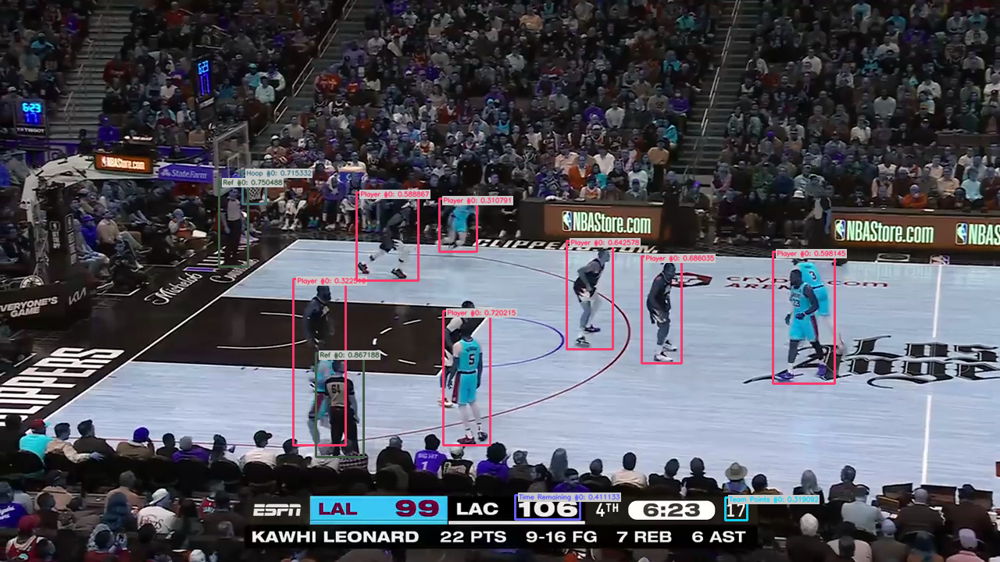

Will run on cuda


Fusing layers... 
yolov9-c summary: 724 layers, 50979420 parameters, 0 gradients, 237.8 GFLOPs


Workflow Untitled run successfully in 1274.047179 ms.


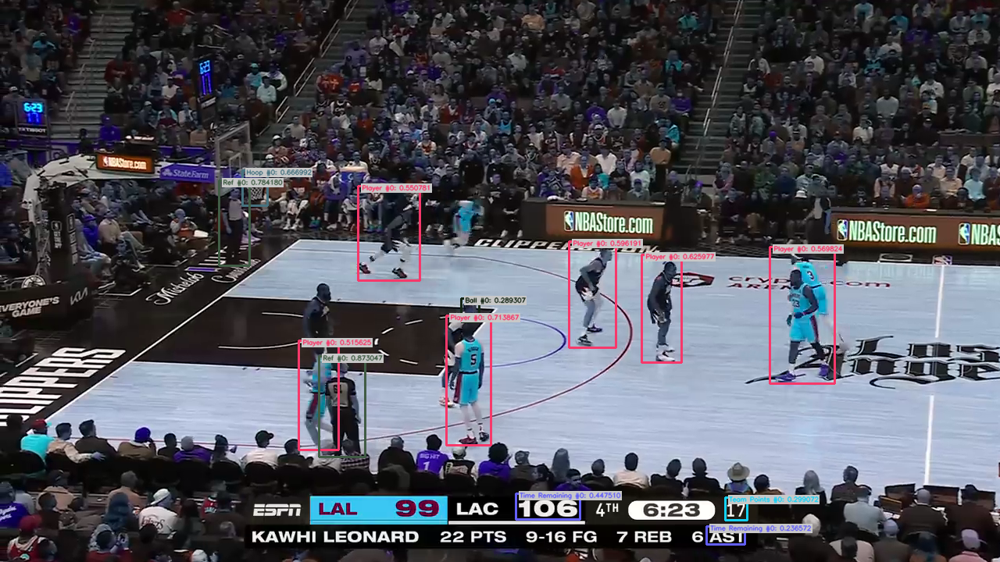

Will run on cuda


Fusing layers... 
yolov9-c summary: 724 layers, 50979420 parameters, 0 gradients, 237.8 GFLOPs


Workflow Untitled run successfully in 1246.288601 ms.


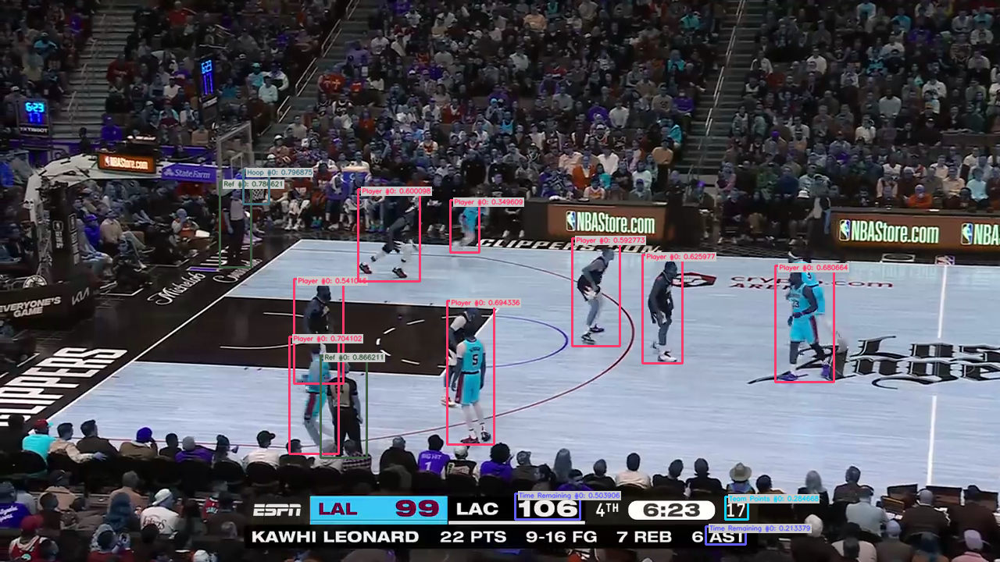

Will run on cuda


Fusing layers... 
yolov9-c summary: 724 layers, 50979420 parameters, 0 gradients, 237.8 GFLOPs


Workflow Untitled run successfully in 1534.245681 ms.


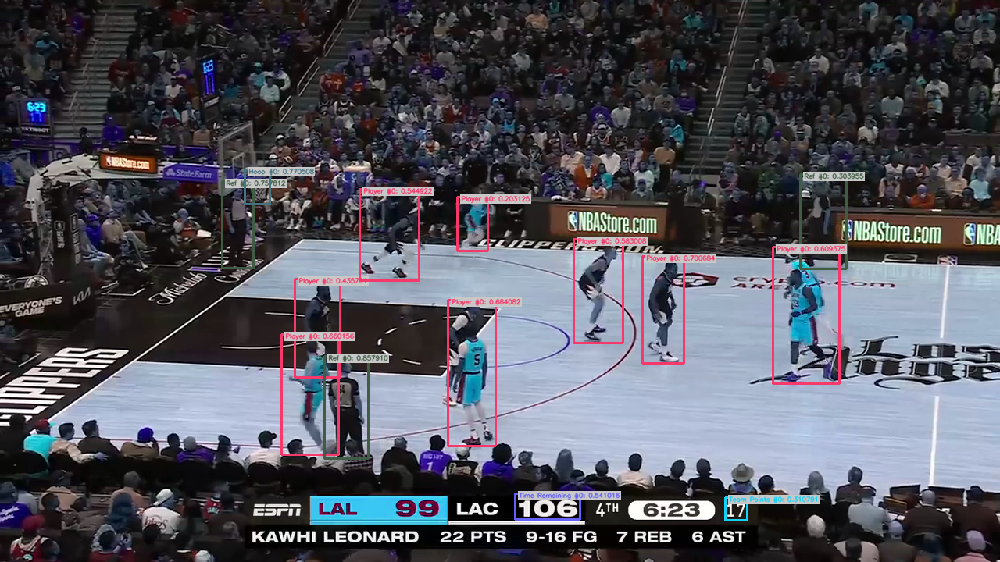

Will run on cuda


Fusing layers... 
yolov9-c summary: 724 layers, 50979420 parameters, 0 gradients, 237.8 GFLOPs


Workflow Untitled run successfully in 1193.502251 ms.


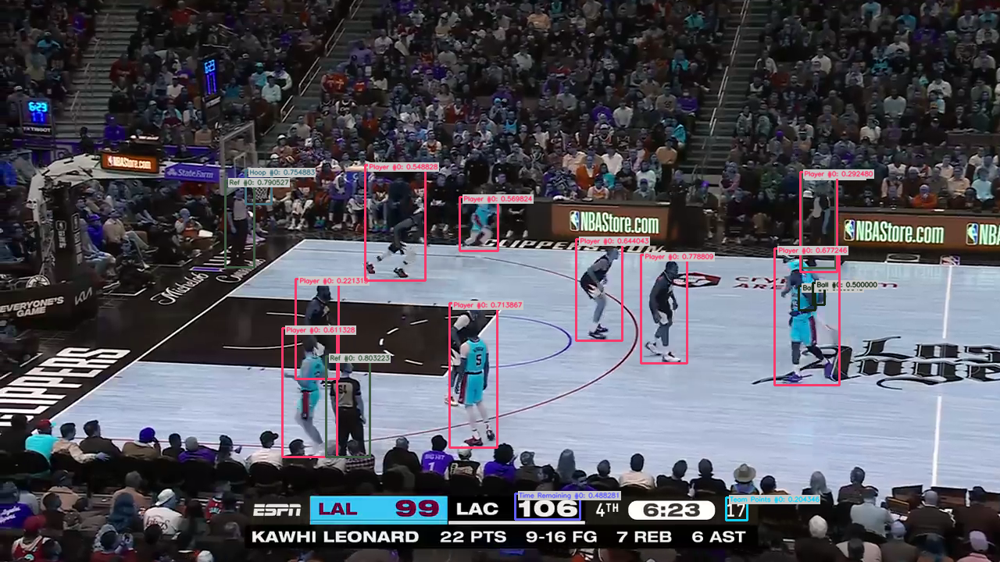

Will run on cuda


Fusing layers... 
yolov9-c summary: 724 layers, 50979420 parameters, 0 gradients, 237.8 GFLOPs


Workflow Untitled run successfully in 1193.035589 ms.


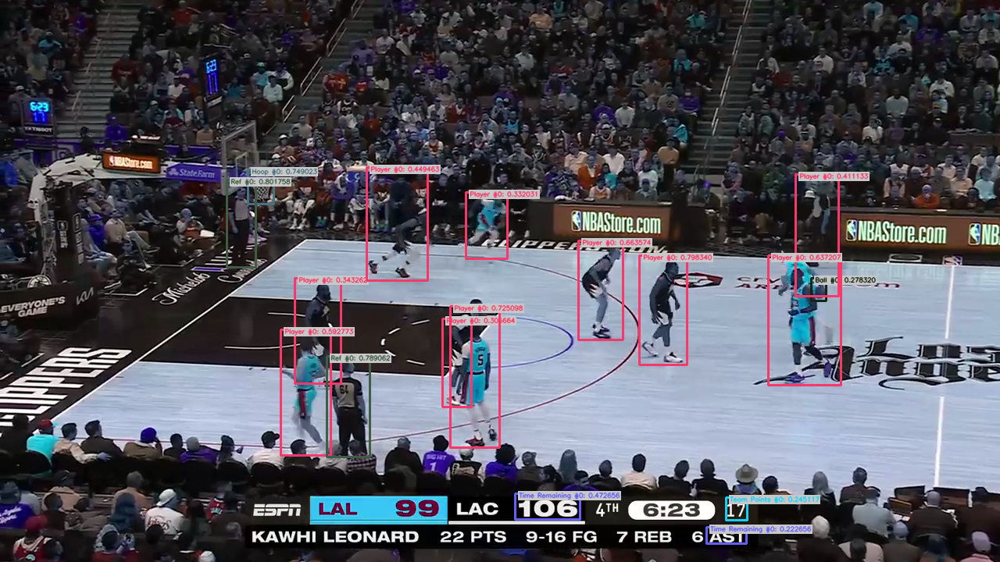

Will run on cuda


Fusing layers... 
yolov9-c summary: 724 layers, 50979420 parameters, 0 gradients, 237.8 GFLOPs


Workflow Untitled run successfully in 1240.645518 ms.


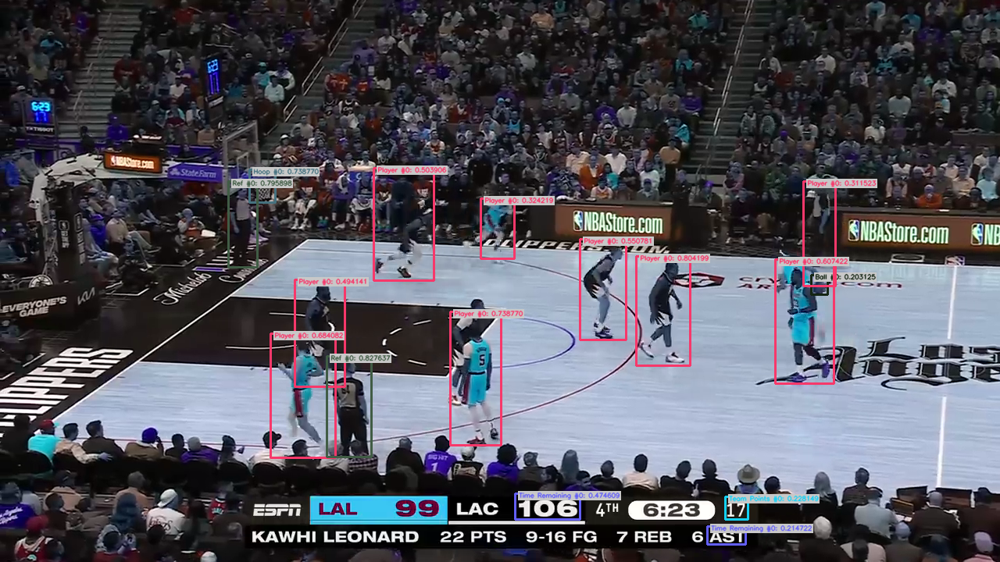

Will run on cuda


Fusing layers... 
yolov9-c summary: 724 layers, 50979420 parameters, 0 gradients, 237.8 GFLOPs


Workflow Untitled run successfully in 1606.800378 ms.


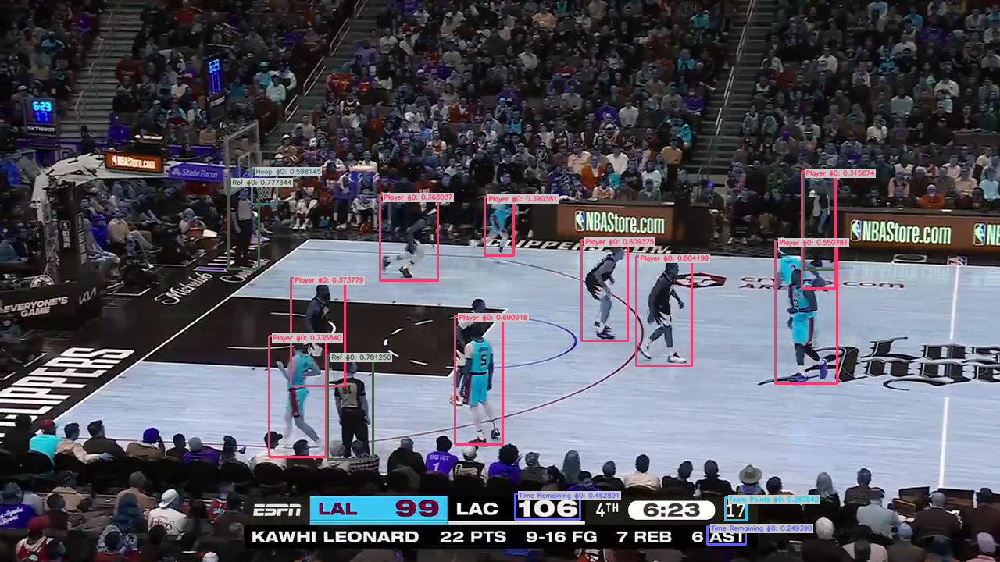

Will run on cuda


Fusing layers... 
yolov9-c summary: 724 layers, 50979420 parameters, 0 gradients, 237.8 GFLOPs


Workflow Untitled run successfully in 1208.611637 ms.


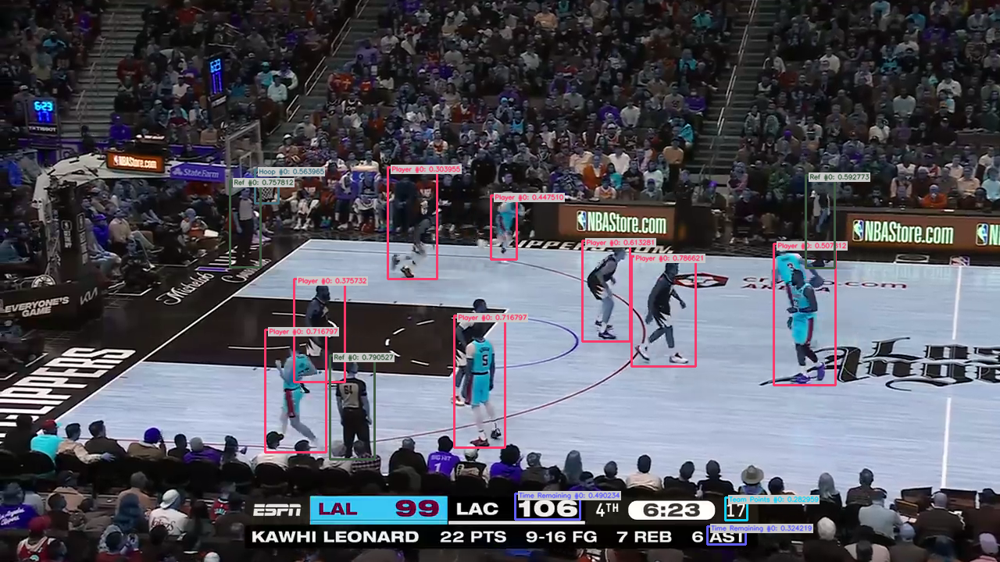

Will run on cuda


Fusing layers... 
yolov9-c summary: 724 layers, 50979420 parameters, 0 gradients, 237.8 GFLOPs


Workflow Untitled run successfully in 1256.224045 ms.


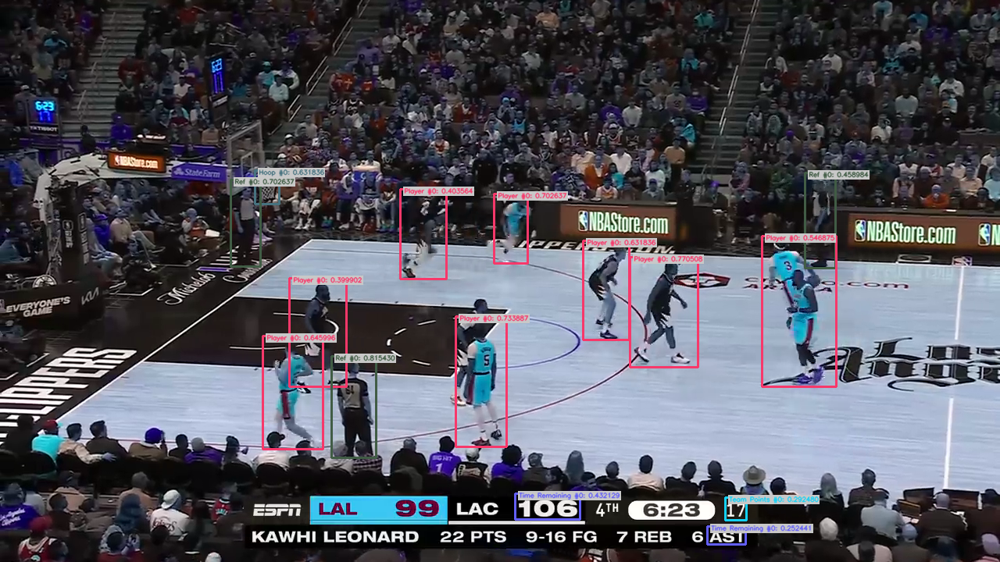

Will run on cuda


Fusing layers... 
yolov9-c summary: 724 layers, 50979420 parameters, 0 gradients, 237.8 GFLOPs


Workflow Untitled run successfully in 1223.942782 ms.


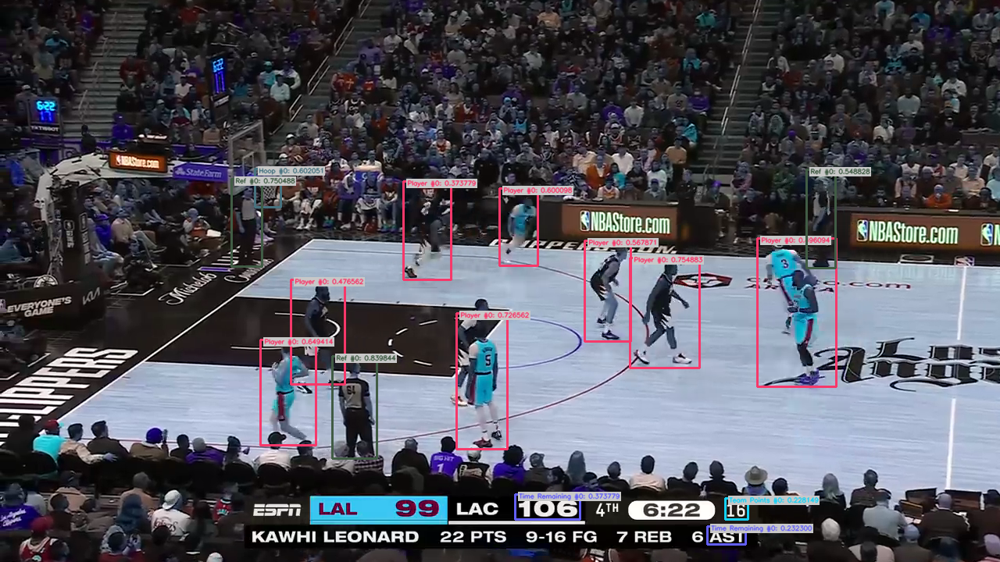

Will run on cuda


Fusing layers... 


In [ ]:
from ikomia.dataprocess.workflow import Workflow
from ikomia.utils.displayIO import display
import cv2
import os

from google.colab.patches import cv2_imshow

path = '/drive/MyDrive/amt3/bbproject/training_output/'
# yolov9.set_parameters({
#     "model_weight_file": os.getcwd()+ f'/{path}/{TIMESTAMP}/weights/best.pt',


TIMESTAMP = "08-04-2024T18h44m03s"
# video_path = 'Path/to/your/video.mp4' # Example: https://www.youtube.com/watch?v=EAR5jTknVOw
video_path = '/content/drive/MyDrive/amt3/vid/basketball_game.mp4'
output_path = '/content/drive/MyDrive/amt3/vid/output_basketball_game.mp4'
# Init your workflow
wf = Workflow()

# Add object detection algorithm
detector = wf.add_task(name="infer_yolo_v9", auto_connect=True)

detector.set_parameters({
    "model_weight_file": os.getcwd()+ f'/{path}/{TIMESTAMP}/weights/best.pt',
    "class_file": os.getcwd()+ f'/{path}/{TIMESTAMP}/classes.yaml',
    "conf_thres": "0.2",
    "iou_thres":"0.25"
})

# Open the video file
stream = cv2.VideoCapture(video_path)
if not stream.isOpened():
    print("Error: Could not open video.")
    exit()

# Get video properties for the output
frame_width = int(stream.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_height = int(stream.get(cv2.CAP_PROP_FRAME_HEIGHT))
frame_rate = stream.get(cv2.CAP_PROP_FPS)

# Define the codec and create VideoWriter object
# The 'XVID' codec is widely supported and provides good quality
fourcc = cv2.VideoWriter_fourcc(*'XVID')
out = cv2.VideoWriter(output_path, fourcc, frame_rate, (frame_width, frame_height))

while True:
    # Read image from stream
    ret, frame = stream.read()

    # Test if the video has ended or there is an error
    if not ret:
        print("Info: End of video or error.")
        break

    # Run the workflow on current frame
    wf.run_on(array=frame)

    # Get results
    image_out = detector.get_output(0)
    obj_detect_out = detector.get_output(1)

    # Convert the result to BGR color space for displaying
    # img_out = image_out.get_image_with_mask_and_graphics(obj_detect_out)
    # img_res = cv2.cvtColor(img_out, cv2.COLOR_RGB2BGR)


    img_out = image_out.get_image_with_mask_and_graphics(obj_detect_out)
    img_res = cv2.cvtColor(img_out, cv2.COLOR_RGB2BGR)

    # Save the resulting frame
    out.write(img_out)

    # Display
    # display(img_res, title="YOLOv9 object detection", viewer="opencv")
    cv2_imshow(img_res)  # Use cv2_imshow instead of display

    # Press 'q' to quit the video processing
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

# After the loop release everything
stream.release()
out.release()
cv2.destroyAllWindows()